<a href="https://colab.research.google.com/github/bhargav23/OpenCV/blob/main/yolo/YoloV5_PyTorch_V4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
imgpath =  "/content/drive/MyDrive/Data/AnnotationImages/"
annotationpath = "/content/annot/"

In [3]:
!pip install tqdm

In [4]:
import pandas as pd 
import os 
from sklearn.model_selection import train_test_split
from tqdm import tqdm


In [5]:
%mkdir annot

In [6]:
%cp /content/drive/MyDrive/Data/temp/annotations/annotations.zip ./annot

In [7]:
cd annot/

/content/annot


In [8]:
!unzip annotations.zip 

Archive:  annotations.zip
 extracting: file72.txt              
 extracting: file73.txt              
 extracting: file78.txt              
 extracting: file75.txt              
 extracting: file74.txt              
 extracting: file99.txt              
 extracting: file79.txt              
 extracting: file83.txt              
 extracting: file86.txt              
 extracting: file94.txt              
 extracting: file102.txt             
 extracting: file82.txt              
 extracting: file89.txt              
 extracting: file88.txt              
 extracting: file132.txt             
 extracting: file106.txt             
 extracting: file127.txt             
 extracting: file100.txt             
 extracting: file118.txt             
 extracting: file108.txt             
 extracting: file85.txt              
 extracting: file123.txt             
 extracting: file130.txt             
 extracting: file121.txt             
 extracting: file92.txt              
 extracting: file122.txt

In [9]:
%rm annotations.zip 

In [10]:
pwd

'/content/annot'

In [11]:
cd /content

/content


In [12]:
def split_img_label(data_train,data_test,imgpath,annotationpath):
    
  os.mkdir('train')
  os.mkdir('valid')
  os.mkdir('train/images')
  os.mkdir('valid/images')
  os.mkdir('train/labels')
  os.mkdir('valid/labels')
  train_images ='./train/images/'
  train_labels = './train/labels/'
  test_images = './valid/images/'
  test_labels= './valid/labels/'
    
    # Train folder
  for index, row in data_train.iterrows():
    os.system('cp ' + imgpath+row[0] +' '+train_images+row[0])
    os.system('cp ' + annotationpath+row[1] +' '+ train_labels+row[1]) 
  
  # Test folder
  for index, row in data_test.iterrows():
    os.system('cp ' + imgpath+row[0] +' '+test_images+row[0])
    os.system('cp ' + annotationpath+row[1] +' '+ test_labels+row[1])

In [13]:
list_img=[img for img in os.listdir(imgpath) if img.endswith('.jpg')==True]
list_txt=[img for img in os.listdir(annotationpath) if img.endswith('.txt')==True]

In [14]:
path_img=[]

for i in range (len(list_img)):
    c = list_img[i].split(".")[0]+'.jpg'
    path_img.append(c)

In [15]:
path_txt=[]

for i in range (len(path_img)):
    t = path_img[i].split(".")[0]+'.txt'
    path_txt.append(t)

In [16]:
df=pd.DataFrame(list(zip(path_img,path_txt)))

In [17]:
# split 
data_train, data_test, labels_train, labels_test = train_test_split(df, df.index, test_size=0.20, random_state=42)

In [18]:
# Function split 
split_img_label(data_train,data_test,imgpath,annotationpath)

In [19]:
cp /content/drive/MyDrive/Data/temp/annotations/data.yaml /content/data.yaml

In [20]:
ls

annot/  data.yaml  drive/  sample_data/  train/  valid/


In [21]:
cat data.yaml

train: ../train/images
val: ../valid/images

nc: 6
names: ['busfront', 'busrear', 'busside', 'frontdoor', 'reardoor', 'busroute']

https://albumentations.ai/docs/examples/pytorch_classification/

In [22]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!git reset --hard 886f1c03d839575afecb059accf74296fad395b6

Cloning into 'yolov5'...
remote: Enumerating objects: 8396, done.
remote: Counting objects: 100% (110/110), done.
remote: Compressing objects: 100% (71/71), done.
remote: Total 8396 (delta 56), reused 77 (delta 39), pack-reused 8286
Receiving objects: 100% (8396/8396), 9.30 MiB | 31.41 MiB/s, done.
Resolving deltas: 100% (5796/5796), done.
/content/yolov5
HEAD is now at 886f1c0 DDP after autoanchor reorder (#2421)


In [23]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 636 kB 8.2 MB/s 
Setup complete. Using torch 1.9.0+cu102 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [24]:
cd /content/

/content


In [25]:
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 6
names: ['busfront', 'busrear', 'busside', 'frontdoor', 'reardoor', 'busroute']

In [26]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [27]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [28]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [29]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [30]:
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 300 --data '../data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

/content/yolov5
github: ⚠️ WARNING: code is out of date by 383 commits. Use 'git pull' to update or 'git clone https://github.com/ultralytics/yolov5' to download latest.
YOLOv5 v4.0-126-g886f1c0 torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='../data.yaml', device='', entity=None, epochs=300, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], linear_lr=False, local_rank=-1, log_artifacts=False, log_imgs=16, multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5s_results', single_cls=False, sync_bn=False, total_batch_size=16, weights='', workers=8, world_size=1)
wandb: Install Weights & Biases for YOLOv5 logging with 'pip install wandb' (recommended)
Start Tensorboard with "tensorboard --logd

In [31]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

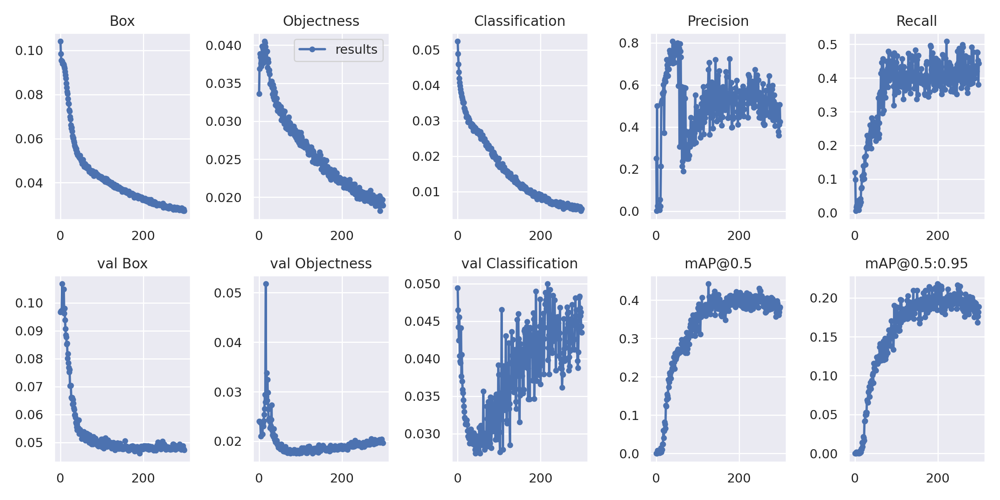

In [32]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/yolov5s_results/results.png', width=1000)  # view results.png

GROUND TRUTH TRAINING DATA:


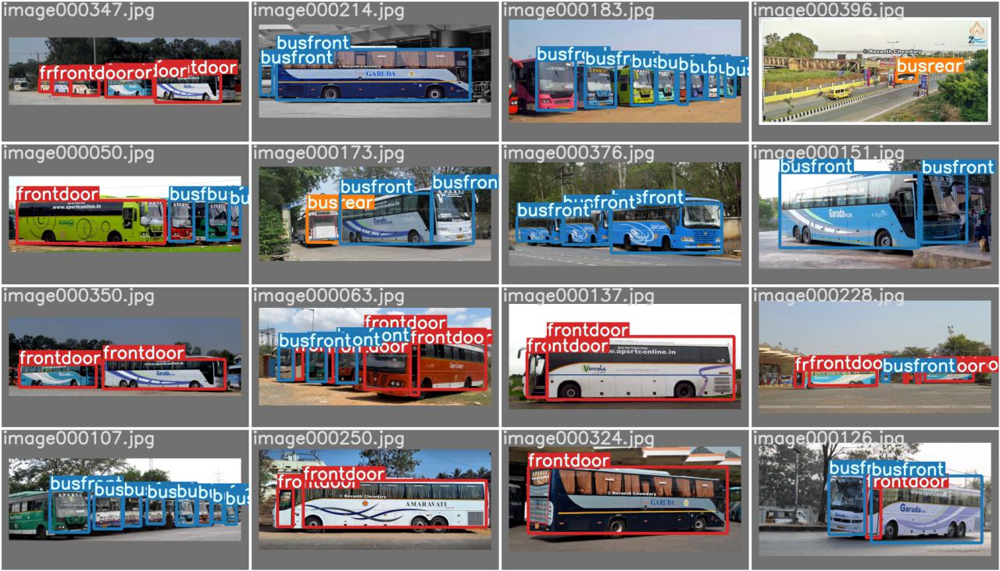

In [33]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/test_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


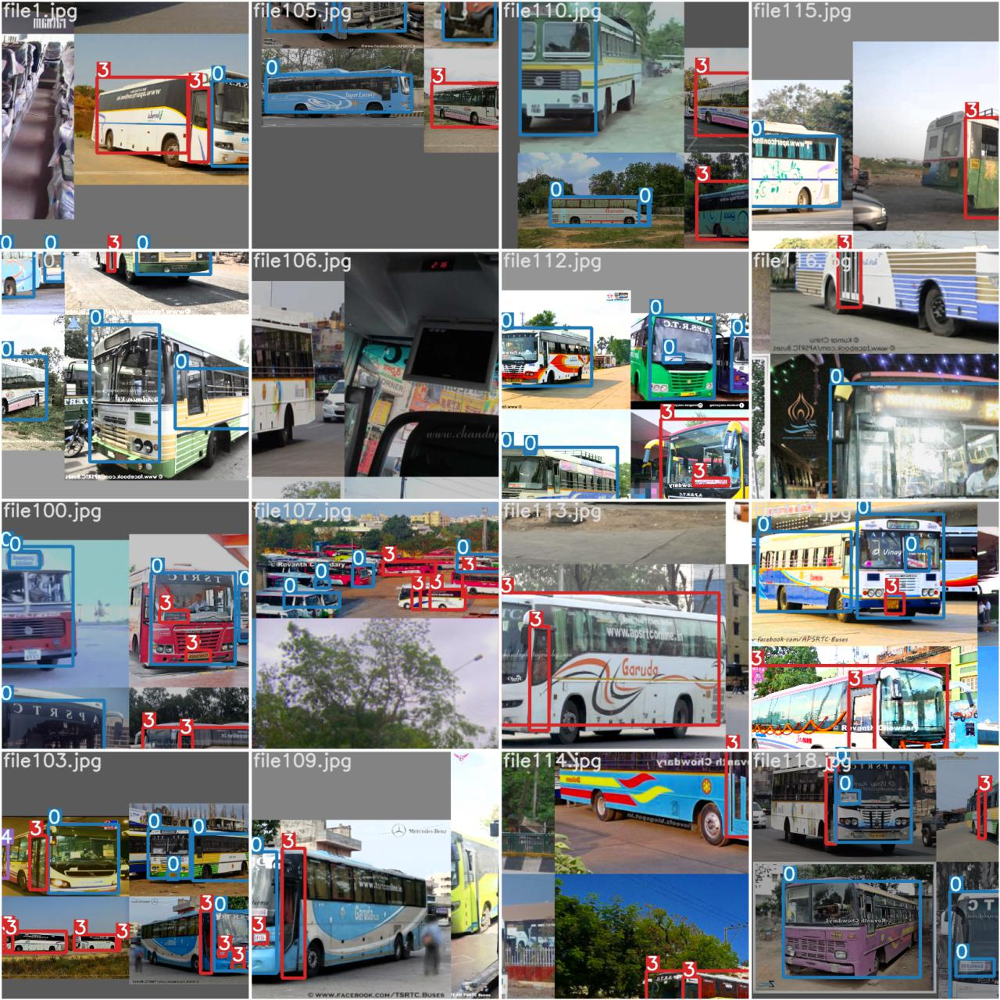

In [34]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/train_batch0.jpg', width=900)

In [35]:
# trained weights are saved by default in our weights folder
%ls runs/

train/


In [36]:
%ls runs/train/yolov5s_results/weights

best.pt  last.pt


In [37]:
cd /content/

/content


In [38]:
%mkdir test

In [39]:
import glob
t = 1
for imageName in glob.glob('/content/drive/MyDrive/Data/BusImages237/*.jpg'): #assuming JPG
  os.system('cp ' + imageName +' '+'/content/test/')
  if (t==100):
    break
  t=t+1

In [40]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source /content/test/

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='/content/test/', update=False, view_img=False, weights=['runs/train/yolov5s_results/weights/best.pt'])
YOLOv5 v4.0-126-g886f1c0 torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
Model Summary: 232 layers, 7260003 parameters, 0 gradients, 16.8 GFLOPS
image 1/100 /content/test/image001478.jpg: 288x416 1 busfront, 1 frontdoor, Done. (0.010s)
image 2/100 /c

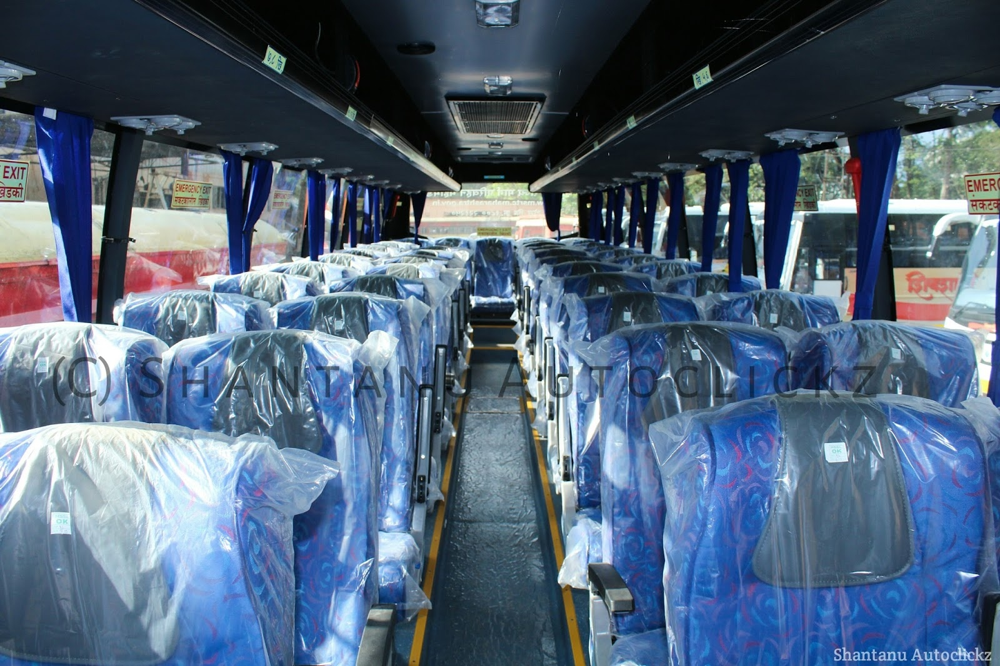

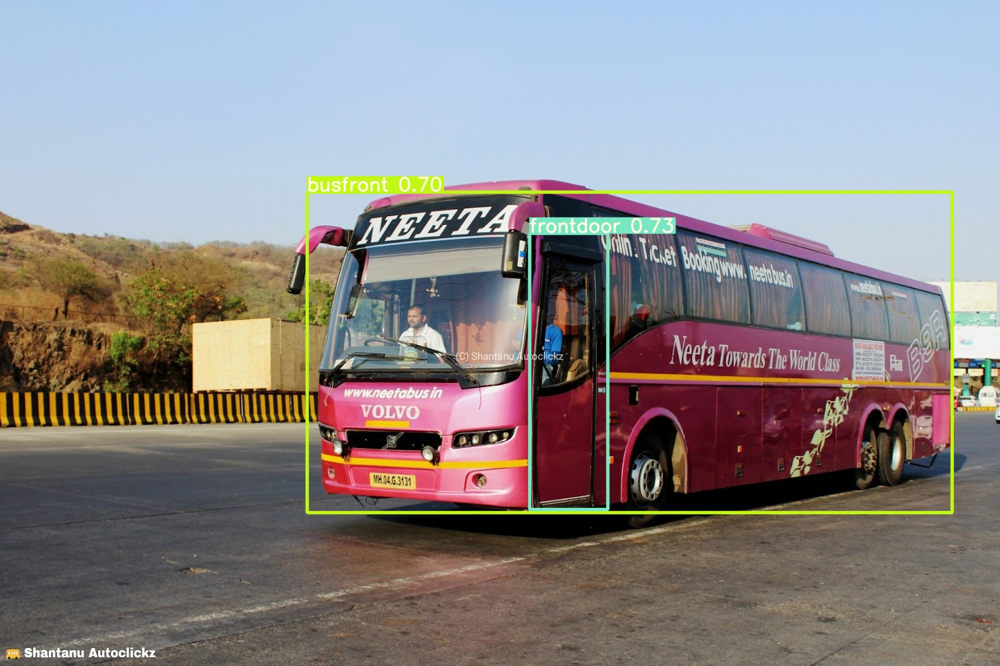

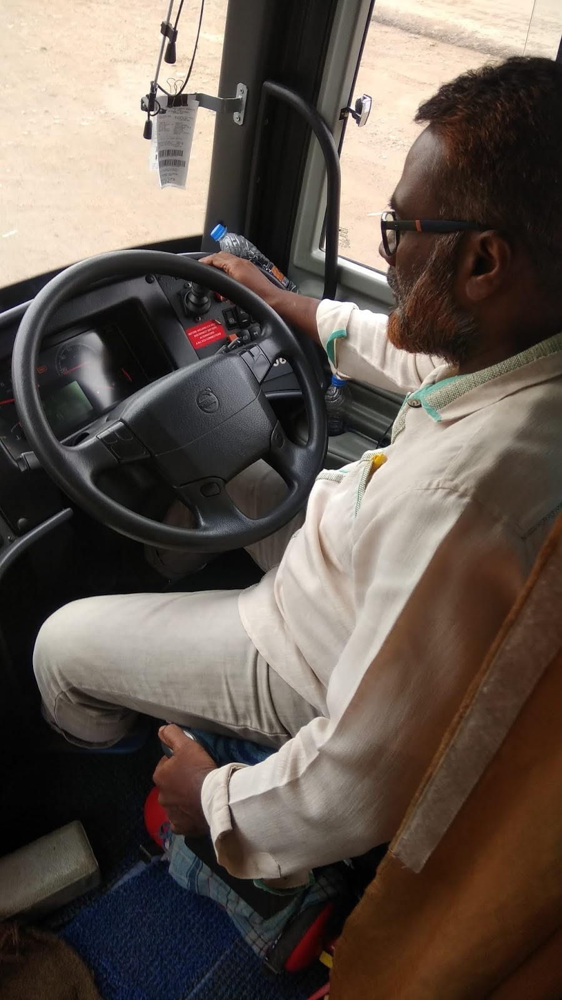

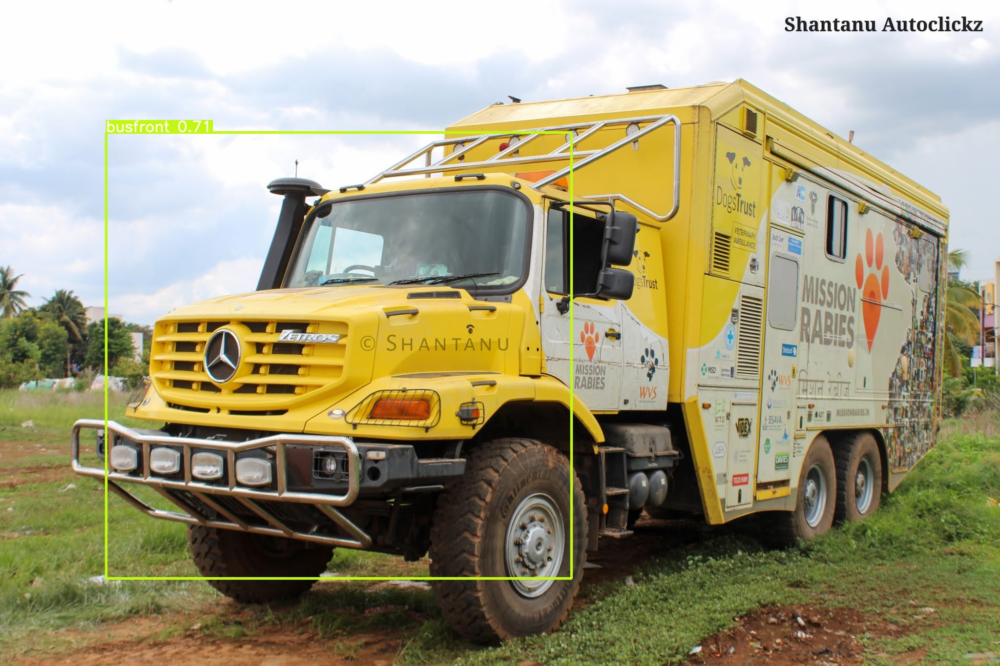

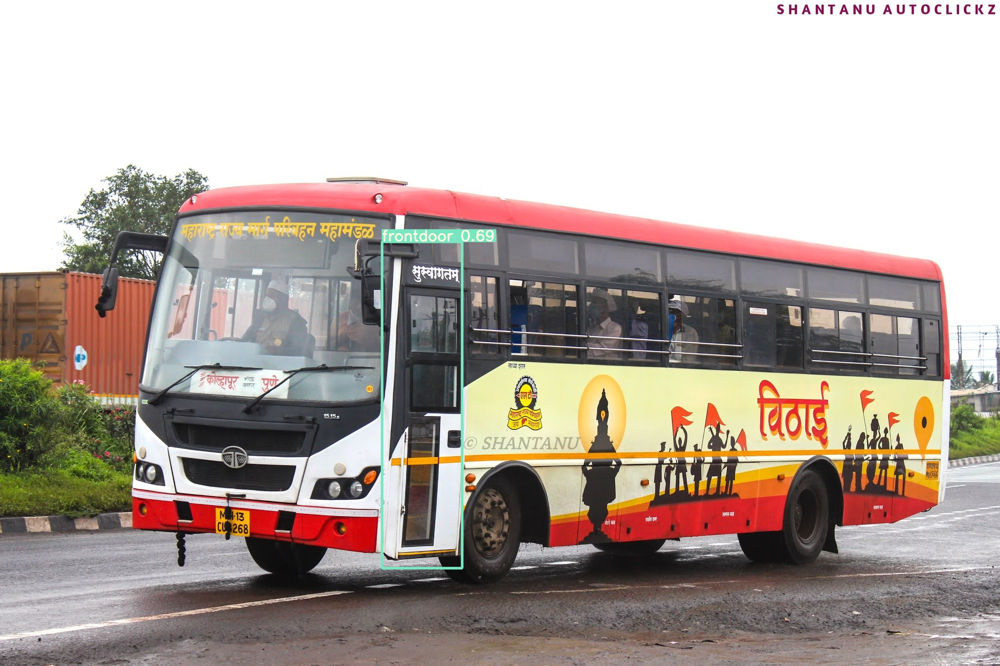

...

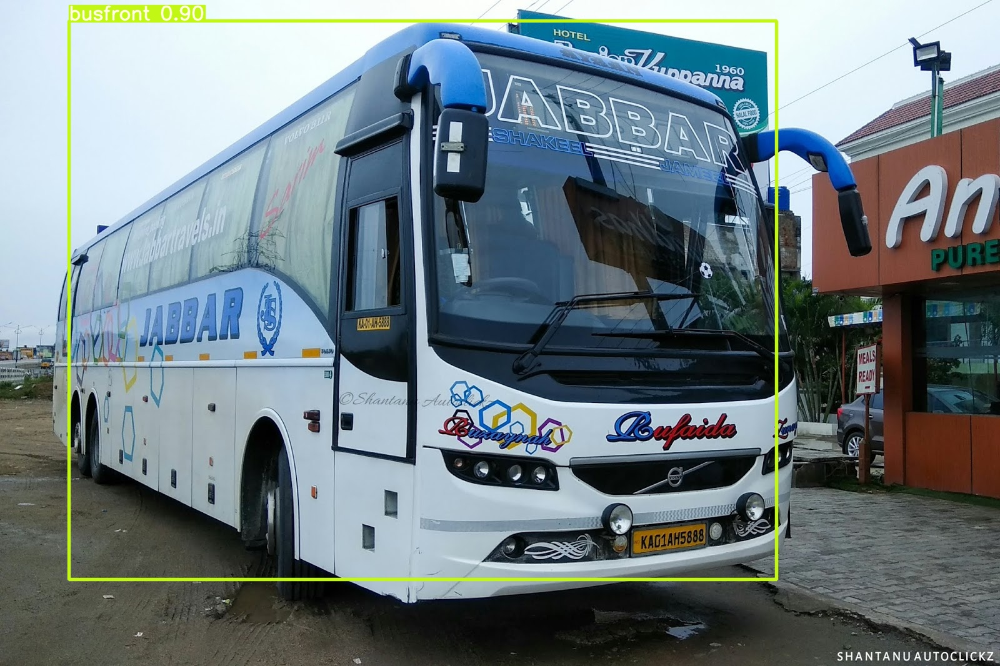

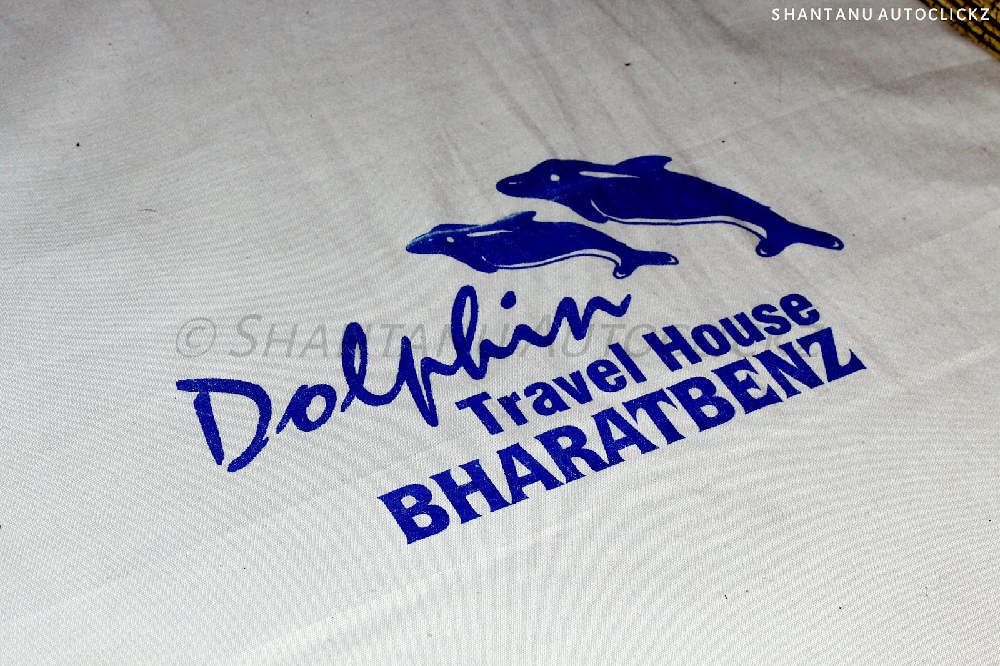

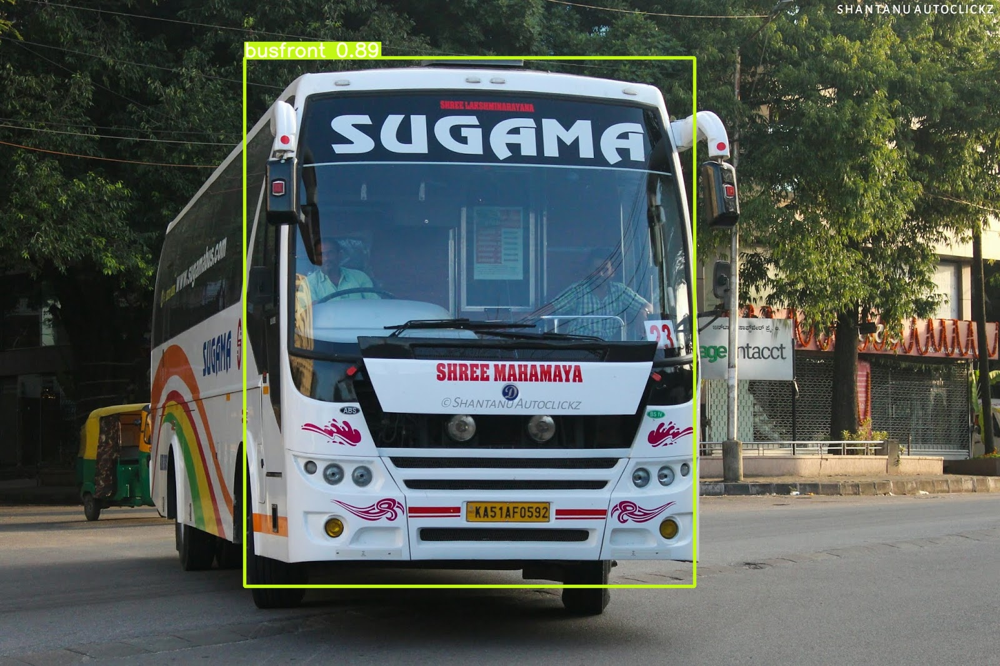

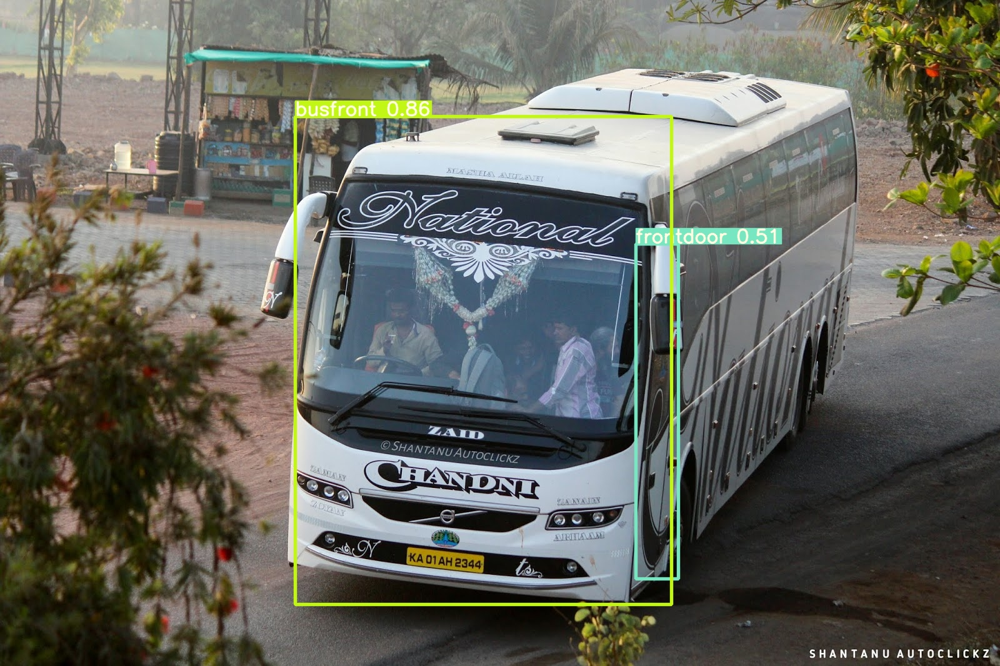

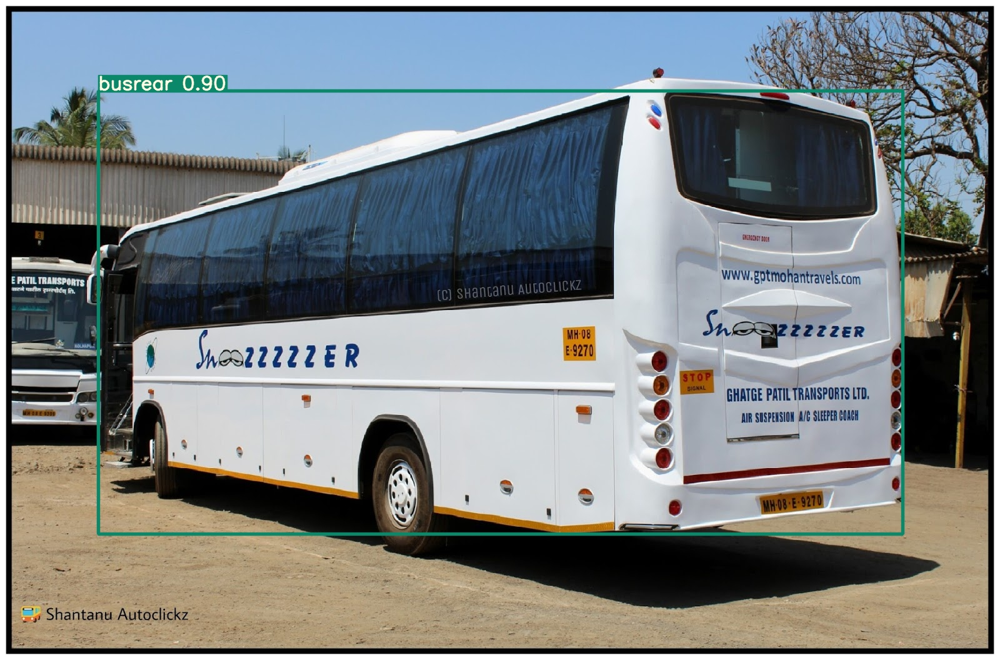

In [41]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display
t = 1
for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")
    if (t==25):
      break
    t=t+1

In [42]:
%cp /content/yolov5/runs/train/yolov5s_results/weights/best.pt /content/drive/MyDrive/Data/models/yolo5257/